## VISAO COMPUTACIONAL
* Detecao facial

In [118]:
import cv2 # BIBLIOTECA PARA RASTREAMENTO DE OBJETOS E IMAGENS

#Carregamennto da imagem

In [119]:
imagem = cv2.imread('/content/workplace.jpg')

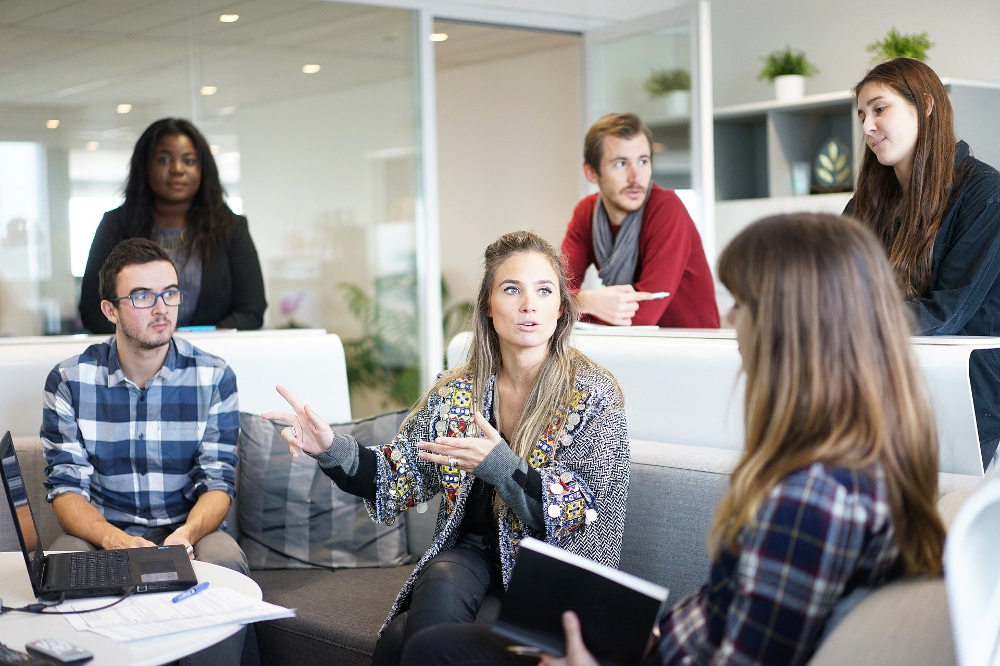

In [120]:
# Leitura da imagem
from google.colab.patches import cv2_imshow 
cv2_imshow(imagem)

#Carregamento do arquivo xml treinado para detencao de imagens

In [121]:
detetor_faces = cv2.CascadeClassifier('/content/haarcascade_frontalface_default.xml')

# Conversao da imagem do canal RGB para o canal de cinza
* Red Green and Blue (RGB) OU Blue Green and Red (para opencv) eh uma sucessao de 3 cores e dificulta o processamento, eis a razao de conversao para um canal de cor unico (Cinza)

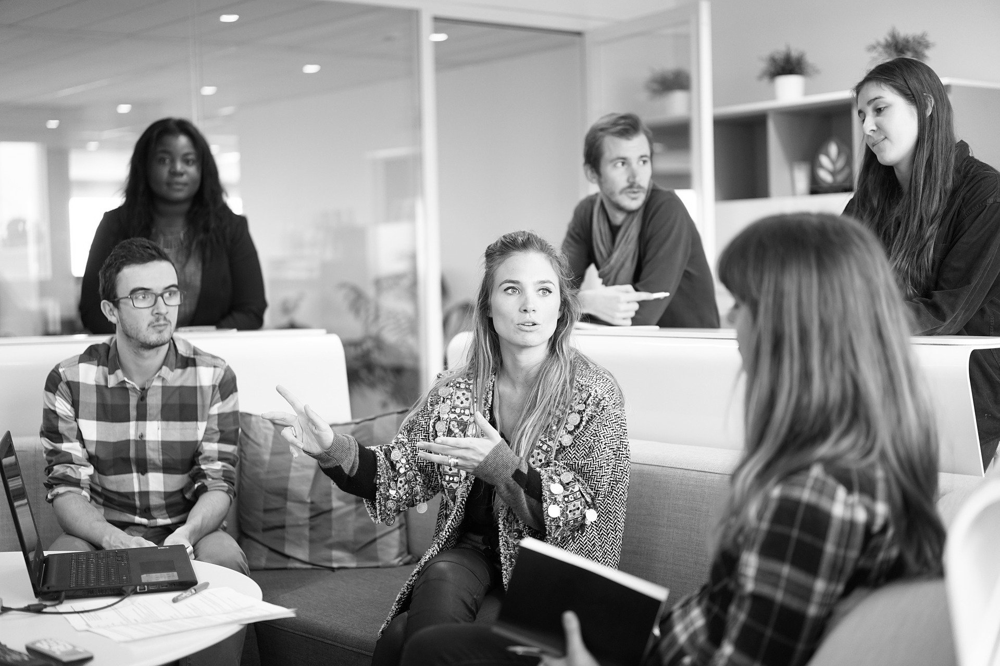

In [122]:
imagem_cinza = cv2.cvtColor(imagem, cv2.COLOR_BGR2GRAY)
cv2_imshow(imagem_cinza)

# APLICACAO DO DETETOR DE FACES (ARQUIVO XML CARREGADO)

In [141]:
Detetar = detetor_faces.detectMultiScale(imagem_cinza, scaleFactor = 1.3, minSize=(30, 30)) # Configuracao dos parametros da imagem
Detetar # Os pontos abaixo indicam a posicao de cada uma da faces

array([[1635,  156,  147,  147],
       [ 284,  262,  114,  114],
       [1149,  260,  129,  129],
       [ 928,  491,  171,  171],
       [ 222,  507,  151,  151]], dtype=int32)

In [142]:
# Tamanho da matriz
len(Detetar)

5

# Definicao do plano cartesiano X, y, l, a
* l = largura
* altura

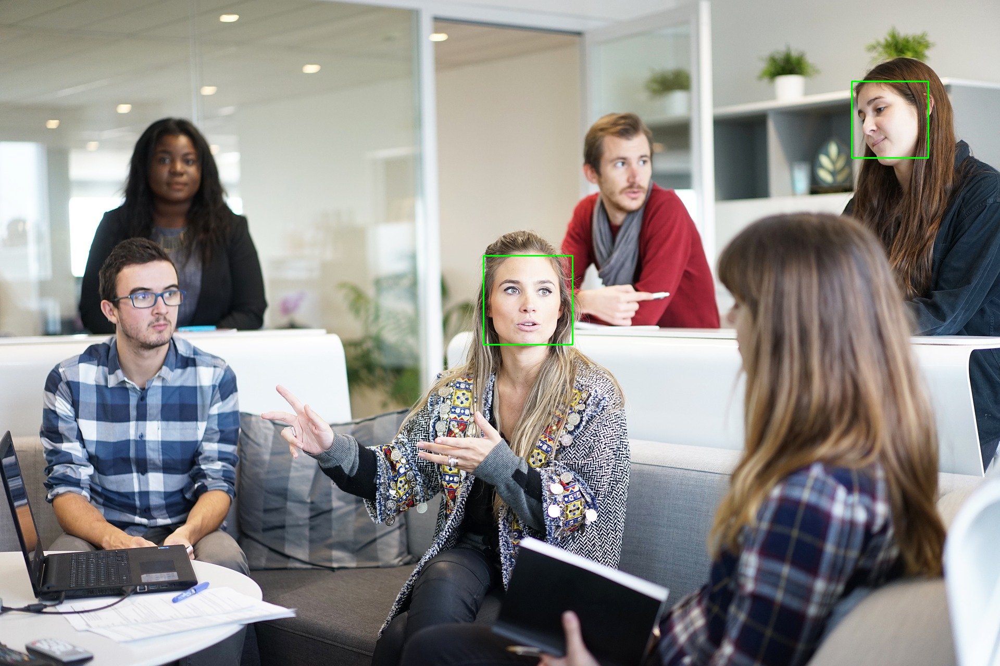

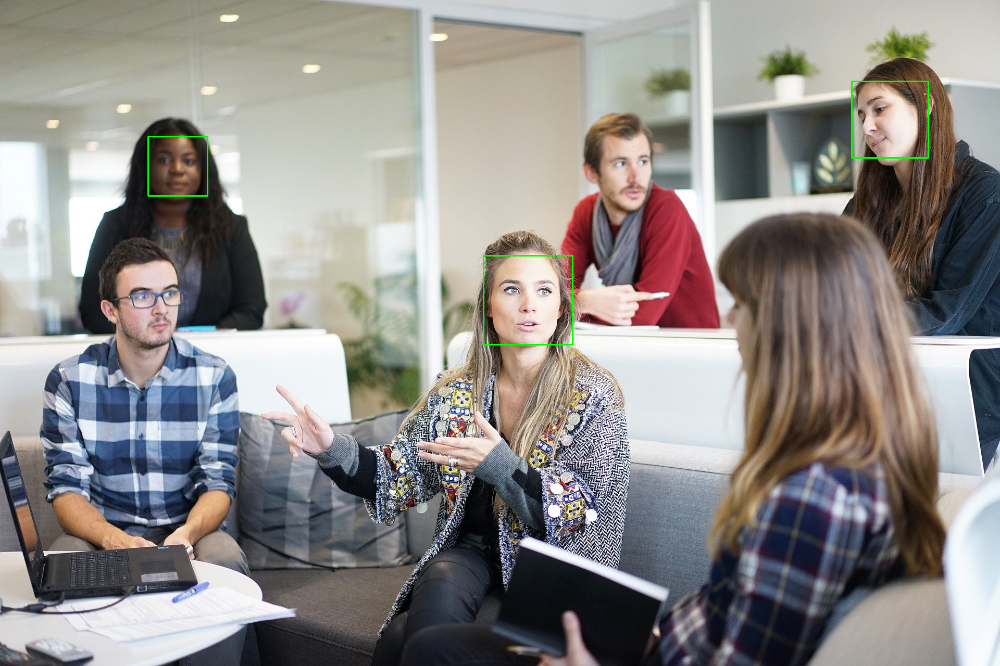

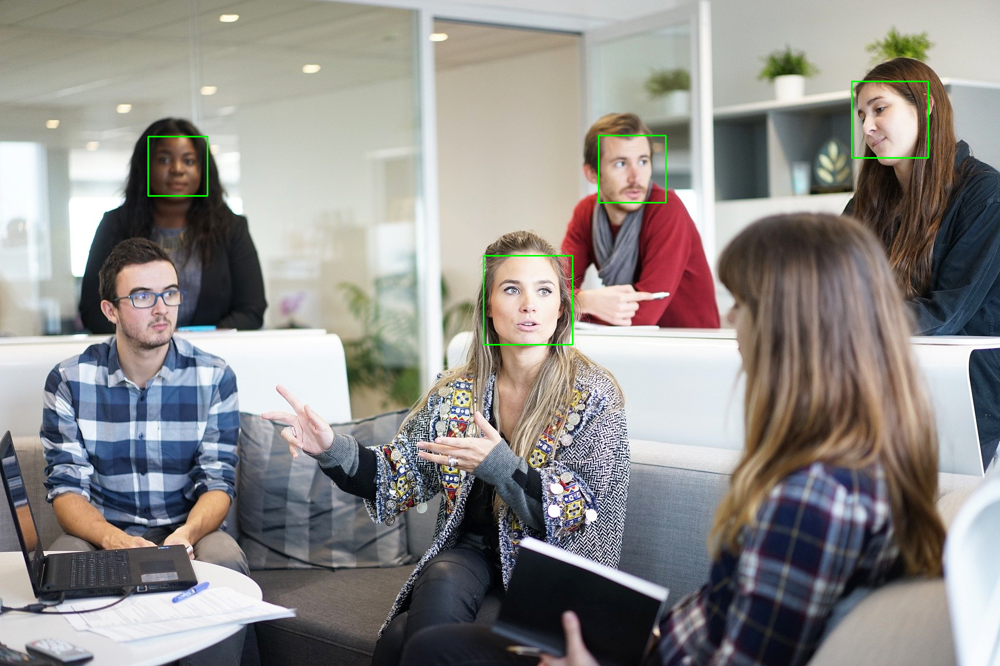

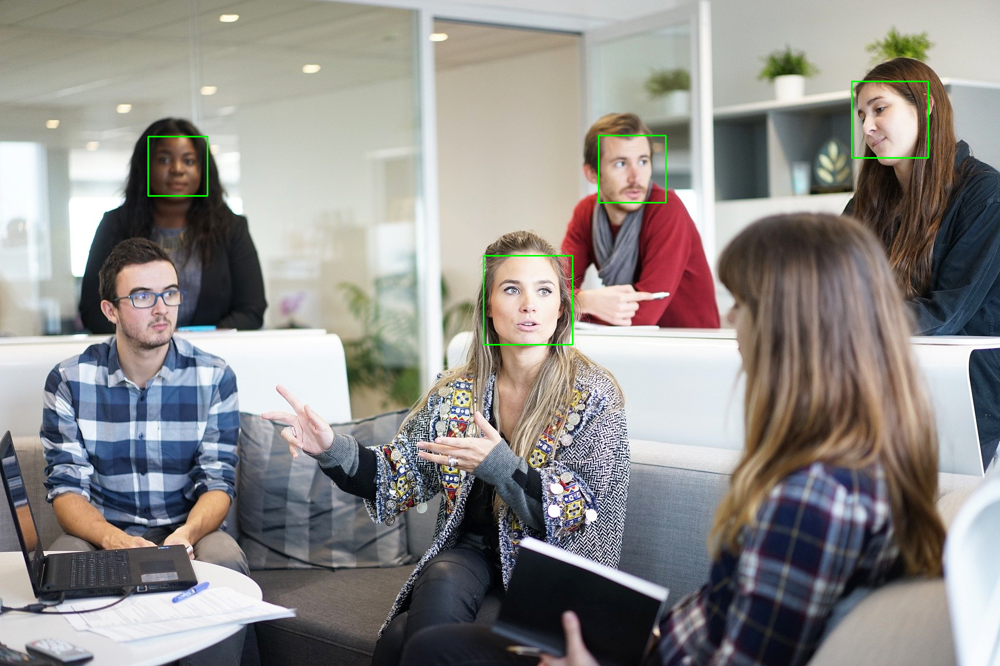

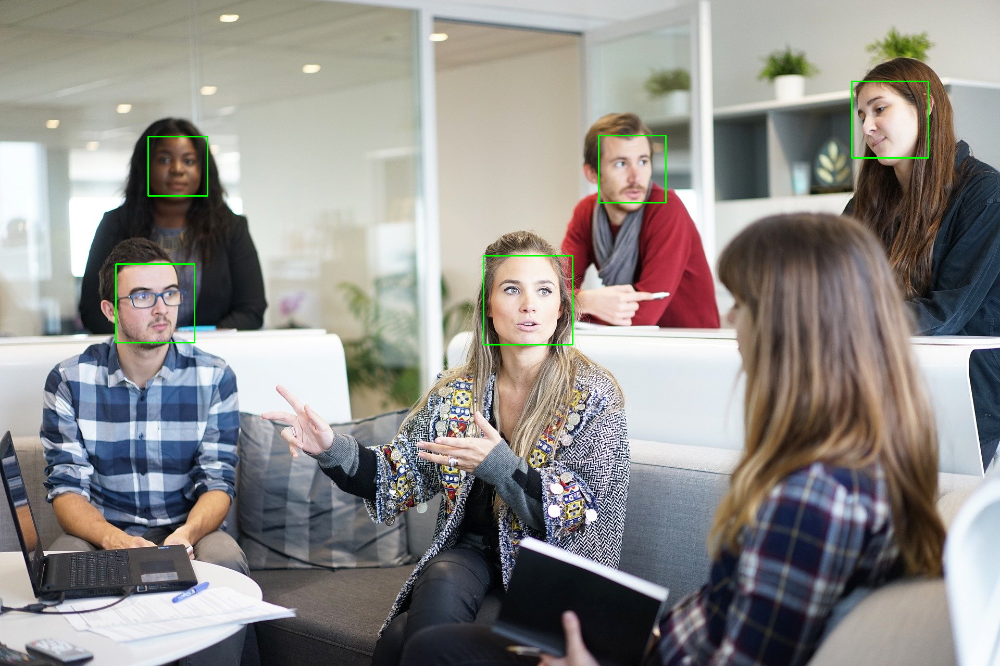

In [143]:
#Carregamento da imagem original para detencao de faces
for (x, y, l, a) in Detetar:
  cv2.rectangle(imagem, (x, y), (x + l, y + a), (0, 255,0), 2)
  cv2_imshow(imagem)

## RESOLUCAO DE EXERCICIO RECONHECIMENTO CORPORAL

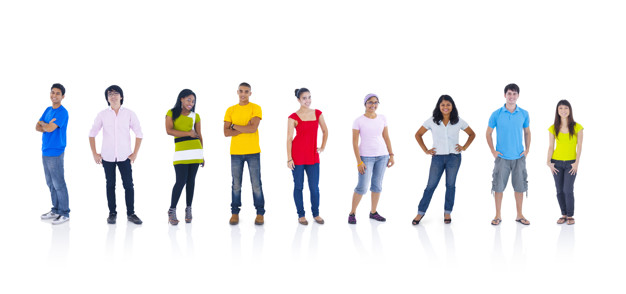

In [126]:
corpo = cv2.imread('/content/pessoas.jpg') # Carregamento das imagens
cv2_imshow(corpo) # Leitura

In [127]:
# Carregamento do xml
detetor_corpo = cv2.CascadeClassifier('/content/fullbody.xml')

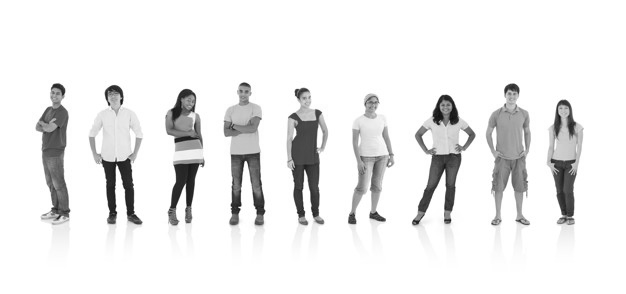

In [128]:
# CONVERSAO PARA COR CINZA
corpo_cinza = cv2.cvtColor (corpo, cv2.COLOR_BGR2GRAY)
cv2_imshow(corpo_cinza)

In [129]:
# DEFINICAO DE PARAMETROS
Decta = detetor_corpo.detectMultiScale(corpo_cinza, minSize=(50, 50), scaleFactor = 1.2)
Decta

array([[134,  55,  90, 180],
       [ 69,  56,  98, 195],
       [462,  61,  86, 172],
       [270,  94,  67, 133],
       [194,  53,  95, 189],
       [325,  68,  87, 173]], dtype=int32)

In [130]:
len(Decta)

6

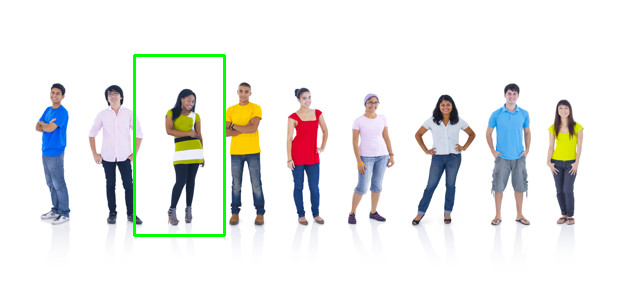

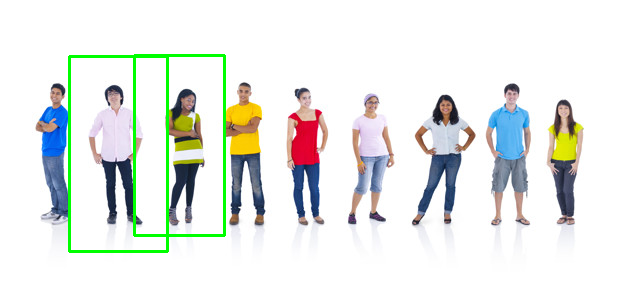

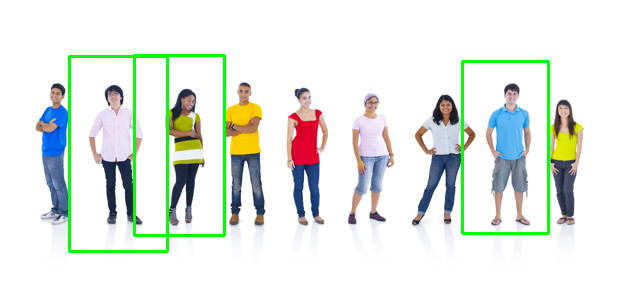

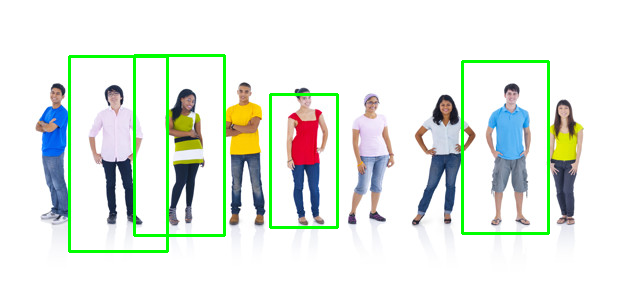

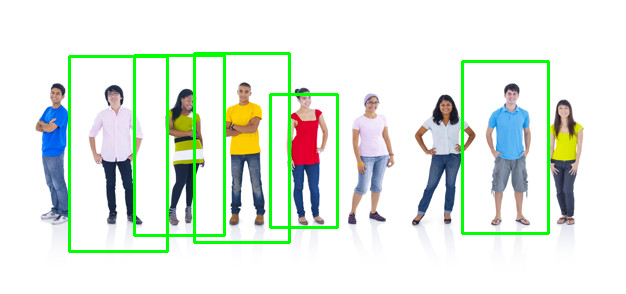

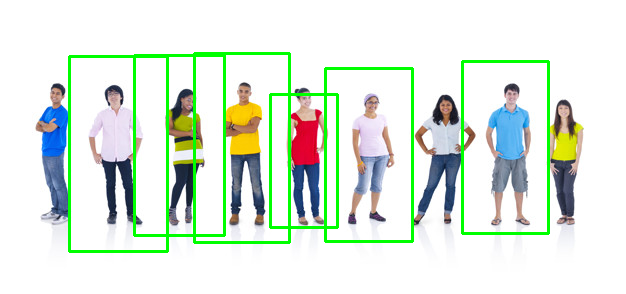

In [131]:
# Detecao de figuras
for (x, y, l, a) in Decta:
  cv2.rectangle(corpo, (x, y), (x+l, y+a), (0, 255, 0), 2)
  cv2_imshow(corpo)


## RECONHECIMENTO FACIAL

In [132]:
from PIL import Image
import numpy as np
from google.colab import drive # PARA CONNECTAR-SE AO COLAB

In [133]:
drive.mount('/content/drive') # Solicitar os arquivos do drive

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [134]:
import os
os.listdir('/content/drive/MyDrive/yalefaces/yalefaces/train')

['subject01.glasses.gif',
 'subject01.leftlight.gif',
 'subject01.noglasses.gif',
 'subject01.normal.gif',
 'subject01.sad.gif',
 'subject01.rightlight.gif',
 'subject01.surprised.gif',
 'subject01.sleepy.gif',
 'subject01.wink.gif',
 'subject02.glasses.gif',
 'subject02.happy.gif',
 'subject02.noglasses.gif',
 'subject02.normal.gif',
 'subject02.rightlight.gif',
 'subject02.sleepy.gif',
 'subject02.sad.gif',
 'subject02.surprised.gif',
 'subject02.wink.gif',
 'subject03.centerlight.gif',
 'subject03.happy.gif',
 'subject03.normal.gif',
 'subject03.noglasses.gif',
 'subject03.rightlight.gif',
 'subject03.sleepy.gif',
 'subject03.sad.gif',
 'subject03.surprised.gif',
 'subject03.wink.gif',
 'subject04.centerlight.gif',
 'subject04.happy.gif',
 'subject04.glasses.gif',
 'subject04.noglasses.gif',
 'subject04.rightlight.gif',
 'subject04.normal.gif',
 'subject04.sleepy.gif',
 'subject05.centerlight.gif',
 'subject04.wink.gif',
 'subject05.happy.gif',
 'subject05.glasses.gif',
 'subject05.

In [135]:
# Leitura e identificacao de id e nomes das faces
def dados_imagem():
  caminhos = [os.path.join('/content/drive/MyDrive/yalefaces/yalefaces/train', f) for f in os.listdir('/content/drive/MyDrive/yalefaces/yalefaces/train')]
  faces = [] # Recebe o nome da pessoa ou face
  ids = [] # Recebe o id da imagem
  for caminho in caminhos:
    imagem = Image.open(caminho).convert('L') # Para abrir no canal de cinza e nao BGR
    imagem_np = np.array(imagem, 'uint8')
    id = int(os.path.split(caminho)[1].split('.')[0].replace('subject',''))
    ids.append(id)
    faces.append(imagem_np)
    return np.array(ids), faces

In [136]:
ids, faces = dados_imagem()

In [137]:
len(ids)

1

In [138]:
len(faces)

1

In [139]:
# TREINAMENTO
classifier = cv2.face.LBPHFaceRecognizer_create() # Criar o classificadorl
classifier.train(faces, ids)
classifier.write('classificator.yml') # Gerar o classificador

## CLASSIFICACAO DAS FACES 

In [168]:
# CARREGAMENTO DO CLASSIFICADOR
recogn = cv2.face.LBPHFaceRecognizer_create()
recogn.read('/content/classificator.yml')

In [169]:
# TESTAR COM IMAGENS DO TESTE
imagem_teste = '/content/drive/MyDrive/yalefaces/yalefaces/test/subject15.rightlight.gif'

In [170]:
imagem = Image.open(imagem_teste).convert('L')
imagem_np = np.array(imagem, 'uint8')
print(imagem_np)

[[101  94  88 ... 255 255 255]
 [221 206 197 ... 255 255 255]
 [203 193 197 ... 255 255 255]
 ...
 [104  98  93 ... 255 255 253]
 [102  95  88 ... 255 252 255]
 [ 68  68  68 ...  68  68  68]]


In [171]:
# Identificar a imagem do link
id_previsao = recogn.predict(imagem_np)
id_previsao

(1, 97.9986748146588)

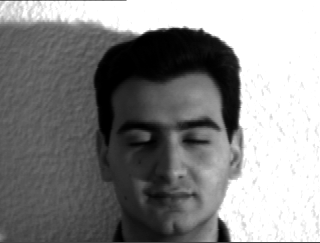

In [172]:
# Abrir imagem prevista
cv2.putText(imagem_np, 'P:' + str(id_previsao), (x,y +30), cv2.FONT_HERSHEY_COMPLEX_SMALL, 1, (0,255,0))
cv2_imshow(imagem_np)